Nota:
Cambiate th_min e th_max con quelli che avete usato per l'esercizio precedente.

Provare a cambiare i seguenti parametri e confrontare i risultati.

number_of_walks (intero),
length (intero),
num_samples (lista di interi),
layer_sizes (lista di interi),
batch_size (intero),
epochs (intero)



In [5]:
#ONLY COLAB
#!pip install stellargraph

In [1]:
import networkx as nx
import numpy as np
import stellargraph as sg

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\requests\__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.9) or chardet (5.1.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


In [2]:
#ONLY COLAB
#from google.colab import drive
#drive.mount('/content/drive', force_remount=True)

In [3]:
#ONLY COLAB
#%cd drive

In [4]:
#ONLY COLAB
#%cd MyDrive

In [5]:
#ONLY COLAB
#%cd GraphSAGE

In [2]:
spikes = {
                      "Omicron1": "Omi1",
                      "Omicron5": "Omi5",
                      "Delta": "Delt",  
                      "Alpha": "Alfa",
                      "Mutant2": "Mt02",
                      "Mutant9": "Mt09",
                      "Mutant10": "Mt10",
                      "Beta": "Beta",
                      "Gamma": "Gamm", 
                      "Zeta":  "Zeta",
                      "Mutant6": "Mt06",
                      "Mutant7": "Mt07",
                      "Mutant13": "Mt13",
                      "Mutant14": "Mt14",
                      "Kappa": "Kapp",
                      "Iota1": "Iota",
                      "Iota2": "Iot2",
                      "Epsilon": "Epsl",
                      "Eta": "Eta1",
                      "Ihu": "Ihu1",
                      "Wild Type": "SPWT"
}

th_min = 4.0
th_max = 8.0

pdbFilesPath = "Data/PDB/"

spike_muts_variants = {"Omicron1": np.array([67, 95, 142, 212, 339, 371, 373, 375, 417, 440, 446, 477, 478, 484, 493, 496, 498, 501, 505, 547, 614, 655, 679, 681, 764, 796, 856, 954, 969, 981]),
                       "Omicron5": np.array([142, 213, 339, 371, 373, 375, 376, 405, 408, 417, 440, 452, 477, 478, 484, 486, 498, 501, 505, 614, 655, 679, 681, 764, 796, 954, 969]),
                       "Delta": np.array([158, 452, 478, 614, 681, 950]),  
                       "Alpha": np.array([501, 570, 614, 681, 716, 982, 1118]),
                       "Mutant2": np.array([501, 681]),
                       "Mutant9": np.array([501, 614, 681]),
                       "Mutant10": np.array([501, 570, 614, 681, 716, 982, 1118]),
                       "Beta": np.array([80, 215, 246, 417, 484, 501, 614, 701]),
                       "Gamma": np.array([138, 190, 417, 484,501, 614, 655, 1027]), 
                       "Zeta":  np.array([484, 614, 1176]),
                       "Mutant6": np.array([417, 484, 501]),
                       "Mutant7": np.array([484]),
                       "Mutant13": np.array([484, 1176]),
                       "Mutant14": np.array([18, 20, 26, 138, 190, 417, 484, 501, 614, 655, 1027, 1176]),
                       "Kappa": np.array([154, 484, 614, 681, 1071]),
                       "Iota1": np.array([5, 95, 253, 477, 614]),
                       "Iota2": np.array([5, 95, 253, 484, 614]),
                       "Epsilon": np.array([13, 152, 452, 614]),
                       "Eta": np.array([52, 67, 484, 614, 677, 888]),
                       "Ihu": np.array([96, 190, 210, 346, 394, 449, 490, 501, 614, 681, 859, 936, 1191]),
                       "Wild Type": np.array([])
                      }

supported_centralities = ["Data/BC", "Data/DC", "Data/EC", "Data/DC", "Data/KC"]

In [3]:
def readPDBFile(pdbFilePath):
    """
    Read the pdb file.
    Parameters: 
        pdbFilePath: string, is the complete PDB file path to read.
    Returns:
        atoms: np.array, contains all the informations contained in the 'ATOM' key of the pdb files. 
    """
    atoms = []
    with open(pdbFilePath) as pdbfile:
        for line in pdbfile:
            if line[:4] == 'ATOM':
                #split the line
                splitted_line = [line[:6], line[6:11], line[12:16], line[17:20], line[21], line[22:26], line[30:38], line[38:46], line[46:54], line[56:61], line[62:66]]
                atoms.append(splitted_line)
    return np.array(atoms)    
    
def getResidueCoordinates(atoms):
    """
    Compute the distances between the alpha carbons of the amino acids.
    Parameters:
        atoms: np.array, contains all the informations contained in the 'ATOM' key of the pdb files. 
    Returns:
        coordinates: np.array, contains the euclidean distance between the alpha carbon of the amino acids of the proteins.  
    """
    x = dict()
    y = dict()
    z = dict()
    
    residues_list = ['ALA', 'CYS', 'ASP', 'GLU', 'PHE', 'GLY', 'HIS', 'ILE', 'LYS', 
                   'LEU', 'MET', 'ASN', 'PRO', 'GLN', 'ARG', 'SER', 'THR', 'VAL', 
                   'TRP', 'TYR']

    last_residue_num = 0

    for i, atom in enumerate(atoms):
        
        residue_name = atom[3]
        residue_chain = atom[4]
        residue_num = int (atom[5])
        
        if residue_name in residues_list:   

            if (residue_num != last_residue_num):
                
                if (atom[2].replace(" ","")=="CA"):
                    cord_C = atom[6:9] 
                    x[residue_name + str (residue_num) + " " + residue_chain] = float(cord_C[0])
                    y[residue_name + str (residue_num) + " " + residue_chain] = float(cord_C[1])
                    z[residue_name + str (residue_num) + " " + residue_chain] = float(cord_C[2])
                    last_residue_num = residue_num   
    
    return x, y, z
     

In [4]:
def dict_from_txt(file):
    
    import ast
    
    with open(file) as f:
        data = f.read()
    
    d = ast.literal_eval(data)
    
    return d

In [5]:
centralities_file_names = {
                            "Data/BC": "betweenness",
                            "Data/EC": "eigenvector_c",
                            "Data/DC": "degree_c",
                            "Data/CC": "closeness",
                            "Data/KC": "katz_c"
                          }

In [6]:
def get_node_features(G):
    
    node_ids = list(G.nodes())
    node_data = dict(G.nodes(data=True))
    features_names = dict(G.nodes(data=True))[list(G.nodes())[0]].keys()
    node_features = pd.DataFrame(index=node_ids)
    
    for name in features_names:
        temp_list = []
        
        for node_id in node_ids:
            temp_list.append(node_data[node_id][name])

        to_concat = pd.DataFrame(temp_list, columns = [name], index=node_ids)
        node_features = pd.concat([node_features, to_concat], axis=1)
        
    return node_features

In [7]:
def map_Graph(G, dict_to_map):
    
    #get residue names
    residue_names = np.array(list(dict_to_map.keys())) 
    mapping = dict()
    old_nodes = list(G.nodes())
    mapped_nodes = []
    for i, residue_name in enumerate(residue_names):
        mapping[i] = residue_name
        mapped_nodes.append(i)

    #relabel nodes
    G = nx.relabel_nodes(G, mapping)
    to_remove = [node for node in old_nodes if node not in mapped_nodes]
    G.remove_nodes_from(to_remove)
    return G, residue_names

In [8]:
def compute_labels(node_ids, name):

    
    for variant in list(spike_muts_variants.keys()):
        if variant in name:
            variant_mutations = spike_muts_variants[variant]
            
    labels = dict()

    for i, node_id in enumerate(node_ids):

        node = int(node_id.split()[0][3:])
        chain = str(node_id.split()[1])
        if node in variant_mutations:
            labels[node_id] = "MUTATED"
        else:
            labels[node_id] = "NOT MUTATED"
                    
    return labels

In [9]:
def add_graph_features(G, name, pdb, supported_centralities, residue_names):
    
    from operator import itemgetter

    #read centralities

    for name_c in supported_centralities:
        
        #read centrality measure for graph G 
        filename = pdb+"_"+centralities_file_names[name_c]
        centr = dict_from_txt("{}/{}.txt".format(name_c, filename))
        sort_centr = dict(sorted(centr.items(), key = itemgetter(1), reverse = True))
        labels = compute_labels(residue_names, name)

        #add centrality as an attribute of the graph G
        nx.set_node_attributes(G, centr, "{}_{}".format(name_c, name))
    
    return G

In [10]:
#create graphs 
import stellargraph as sg
import pandas as pd 

G_s = dict()
A_s = dict()

variants = list(spike_muts_variants.keys())
variants.append("WT")
types = ["closed"]

feature_names_taken = False 
feature_names = []

for name, pdb in spikes.items():
    
    print(name)
    #read PCN
    A = np.loadtxt(r"Data/Adj/{}_adj_mat_{}_{}.txt".format(pdb.lower(), str(th_min), str(th_max)))
    A_s[name] = A
    #create the nx.graph
    G = nx.from_numpy_array(A)
    
    pdbFilePath = pdbFilesPath + "{}.pdb".format(pdb)
    atoms = readPDBFile(pdbFilePath)
    x, y, z = getResidueCoordinates(atoms)
    
    #map labels     
    G, residue_names = map_Graph(G, x)
    
    #add cordinates as Graph attributes           
    nx.set_node_attributes(G, x, "x")
    nx.set_node_attributes(G, y, "y")
    nx.set_node_attributes(G, z, "z")
    
    G = add_graph_features(G, name, pdb.lower(), supported_centralities, residue_names)
    
    if "Wild Type" not in name:
        for type_ in types:
            if type_ in name:
                G = add_graph_features(G, "WT_{}".format(type_), pdb.lower(), supported_centralities, residue_names)

    if not feature_names_taken:
        features_names = dict(G.nodes(data=True))[list(G.nodes())[0]].keys()
        for i, feature_name in enumerate(feature_names):
            feature_names[i] = feature_name.replace(name, "{}")

    #save the graph (G) in the dictionary of Graphs (G_s)
    node_features = get_node_features(G)
    G_s[name] = sg.StellarGraph.from_networkx(G, node_features = node_features)

Omicron1
Omicron5
Delta
Alpha
Mutant2
Mutant9
Mutant10
Beta
Gamma
Zeta
Mutant6
Mutant7
Mutant13
Mutant14
Kappa
Iota1
Iota2
Epsilon
Eta
Ihu
Wild Type


In [43]:
features_names

dict_keys(['x', 'y', 'z', 'Data/BC_Wild Type', 'Data/DC_Wild Type', 'Data/EC_Wild Type', 'Data/KC_Wild Type'])

In [44]:
G_s["Wild Type"].node_features()

array([[1.4019000e+02, 6.7055000e+01, 1.1240500e+02, ..., 1.2360939e-03,
        4.7647958e-05, 9.2428634e-03],
       [8.0959999e+01, 1.3785500e+02, 9.0514999e+01, ..., 1.8541409e-03,
        7.3229567e-06, 1.1666482e-02],
       [7.7610001e+01, 1.3629500e+02, 9.1724998e+01, ..., 2.1631643e-03,
        9.1476486e-06, 1.3829234e-02],
       ...,
       [3.9930000e+01, 7.6665001e+01, 1.7784500e+02, ..., 2.1631643e-03,
        5.7381490e-06, 5.4342602e-03],
       [3.9500000e+01, 8.0495003e+01, 1.7896500e+02, ..., 1.5451175e-03,
        3.4835109e-06, 4.8646769e-03],
       [3.7980000e+01, 7.9224998e+01, 1.8219501e+02, ..., 6.1804696e-04,
        1.0899596e-06, 3.3535233e-03]], dtype=float32)

In [45]:
G_s["Omicron1"].node_features()

array([[8.7330002e+01, 1.3686000e+02, 5.8959999e+01, ..., 1.2430081e-03,
        3.6405772e-06, 6.9833263e-03],
       [8.7849998e+01, 1.3522000e+02, 6.2439999e+01, ..., 1.5537601e-03,
        6.1674509e-06, 8.2316855e-03],
       [8.6220001e+01, 1.3538000e+02, 6.5949997e+01, ..., 2.1752641e-03,
        8.9028190e-06, 1.0577356e-02],
       ...,
       [1.0871000e+02, 1.2889000e+02, 1.7669000e+02, ..., 1.2430081e-03,
        2.2229586e-05, 3.5747394e-03],
       [1.0875000e+02, 1.3264000e+02, 1.7771001e+02, ..., 9.3225605e-04,
        7.7754057e-06, 3.0847734e-03],
       [1.0588000e+02, 1.3248000e+02, 1.8036000e+02, ..., 9.3225605e-04,
        8.0440859e-06, 3.0933204e-03]], dtype=float32)

In [46]:
print(G_s["Wild Type"].info())

StellarGraph: Undirected multigraph
 Nodes: 3236, Edges: 11802

 Node types:
  default: [3236]
    Features: float32 vector, length 7
    Edge types: default-default->default

 Edge types:
    default-default->default: [11802]
        Weights: all 1 (default)
        Features: none


In [47]:
G_s["Wild Type"].nodes()

Index(['ALA27 A', 'TYR28 A', 'THR29 A', 'ASN30 A', 'SER31 A', 'PHE32 A',
       'THR33 A', 'ARG34 A', 'GLY35 A', 'VAL36 A',
       ...
       'VAL1137 C', 'TYR1138 C', 'ASP1139 C', 'PRO1140 C', 'LEU1141 C',
       'GLN1142 C', 'PRO1143 C', 'GLU1144 C', 'LEU1145 C', 'ASP1146 C'],
      dtype='object', length=3236)

In [ ]:
#ONLY COLAB
#import plotly.io as pio
#pio.renderers.default = "colab"

In [11]:
def visualize_embeddings3D(G, node_embeddings, name, batch_size, num_samples):
    
    from sklearn.manifold import TSNE
    from sklearn.decomposition import PCA
    import pandas as pd
    import numpy as np
    from tensorflow import keras
    import matplotlib.pyplot as plt
    import plotly.express as px
    
    node_ids = list(G.nodes())
    features = G.node_features()
    
    for variant in list(spike_muts_variants.keys()):
        if variant in name:
            variant_mutations = spike_muts_variants[variant]
            
    domains = {
    "NTD": np.arange(14, 305, 1),
    "CT0": np.arange(306, 330, 1),
    "RBD":  np.arange(331, 527, 1),
    "CT1": np.arange(528, 590, 1),
    "CT2": np.arange(591, 685, 1),
    "S2S2'": np.arange(686, 815, 1),
    "FP": np.arange(816, 885, 1),
    "FPR": np.arange(886, 911, 1),
    "HR1": np.arange(912, 984, 1),
    "CH": np.arange(985, 1034, 1),
    "CD": np.arange(1035, 1080, 1),
    "CD1": np.arange(1081, 1147, 1),
    }

    X = node_embeddings

    if X.shape[1] > 2:
        
        transform2 = TSNE
        trans2 = transform2(n_components=2, learning_rate='auto', init = "random")
        emb_transformed2 = pd.DataFrame(trans2.fit_transform(X), columns = ["1","2"], index = node_ids)
    
    elif X.shape[1] == 2:

        emb_transformed2 = pd.DataFrame(X, index = node_ids)
        print(emb_transformed2)
        emb_transformed2 = emb_transformed2.rename(columns=["node","1","2"])
    
    else:
        raise Exception("X.shape[1] must be >= to 2. Given X with shape {}".format(X.shape[1]))

    """3D PLOTS
    if X.shape[1] > 3:
        
        transform = TSNE
        trans = transform(n_components=3, learning_rate='auto', init = "random")
        emb_transformed = pd.DataFrame(trans.fit_transform(X), columns = ["1","2","3"], index = node_ids)
    
    elif X.shape[1] == 3:

        emb_transformed = pd.DataFrame(X, index = node_ids)
        emb_transformed = emb_transformed.rename(columns=["node","1","2","3"])
    
    else:
        raise Exception("X.shape[1] must be >= to 3. Given X with shape {}".format(X.shape[1]))
    """
        
    label_str = np.zeros((len(node_ids)), dtype = "U14")
    label_int = np.zeros((len(node_ids)), dtype = int)
    domain_label_list = np.zeros((len(node_ids)), dtype = "U3")
    
    for i, node_id in enumerate(node_ids):

        node = int(node_id.split()[0][3:])
        chain = str(node_id.split()[1])

        if node in variant_mutations:
           label_str[i] = "MUTATED"
           label_int[i] = 1
        else:
           label_str[i] = "NOT MUTATED"
           label_int[i] = 0
           #color based on mutated 
          
        found_domain = False
        for domain, residues_in_domain in domains.items():
           if node in residues_in_domain:
               domain_label_list[i] = domain
               found_domain = True
                    
        if not found_domain:
            domain_label_list[i] = "S2'"
        
    #emb_transformed["label"] = label_str
    #emb_transformed["domain"] = domain_label_list
    emb_transformed2["label"] = label_str
    emb_transformed2["domain"] = domain_label_list
    emb_transformed2 = emb_transformed2.sort_values("label", ascending = False)

    #add all features to hover_data
     
    #visualize
    #2d plot
    
    fig1 = px.scatter(emb_transformed2, x="1", y="2", color="label", color_discrete_sequence=["#636EFA", "#EF553B"], hover_name = emb_transformed2.index,
                        hover_data=['domain'], opacity = 0.9,  
                        title = "{} 2D visualization of GraphSAGE embeddings colored by mutated residues for spike protein {}".format(transform2.__name__, name))
    fig1.write_html("Figures/GraphSAGE_Figures/{}_2D_Mutated.html".format(name))
    fig1.show()

    
    fig2 = px.scatter(emb_transformed2, x="1", y="2", color="domain", hover_name = emb_transformed2.index,
                      hover_data=['label'], opacity = 0.9,  
                      title = "{} 2D visualization of GraphSAGE embeddings colored by domain of the spike protein {}".format(transform2.__name__, name))
    fig2.write_html("Figures/GraphSAGE_Figures/{}_2D_Domains.html".format(name))
    fig2.show()
    
    """
    #3d 
    
    
    fig3 = px.scatter_3d(emb_transformed, x='1', y='2', z='3', hover_name = emb_transformed.index, hover_data = ['label'],
                         color='domain', title = "{} 3D visualization of GraphSAGE embeddings colored by domains for spike protein {}".format(transform.__name__, name),
                         opacity = 0.9)
    fig3.write_html("Figures/{}_3D_Domains.html".format(name))
    #fig3.show()
    
    fig4 = px.scatter_3d(emb_transformed, x='1', y='2', z='3', hover_name = emb_transformed.index, hover_data = ['domain'], 
                         color='label', title = "{} 3D visualization of GraphSAGE embeddings colored by mutated residues for spike protein {}".format(transform.__name__, name),
                         opacity = 0.9)
    fig4.write_html("Figures/{}_3D_Mutated.html".format(name))
    #fig4.show()
    """

    return fig1, fig2

In [12]:
def unsupervisedGraphSAGE(G, name, number_of_walks=50, length=20, batch_size=2, epochs=40, num_samples = [10], layer_sizes=[20]):
    
        
    from stellargraph.mapper import GraphSAGELinkGenerator
    from stellargraph.layer import GraphSAGE
    from stellargraph.mapper import GraphSAGENodeGenerator
    from stellargraph.data import UnsupervisedSampler
    from tensorflow import keras
    
    nodes = list(G.nodes())
    unsupervised_samples = UnsupervisedSampler(G, nodes=nodes, length=length, number_of_walks=number_of_walks)
    generator = GraphSAGELinkGenerator(G, batch_size, num_samples)
    train_gen = generator.flow(unsupervised_samples)
    graphsage = GraphSAGE(
        layer_sizes=layer_sizes, generator=generator, bias=True, dropout=0.5 #normalize="l2"
    )
    x_inp, x_out = graphsage.in_out_tensors()   
    
    x_inp_src = x_inp[0::2]
    x_out_src = x_out[0]
    embedding_model = keras.Model(inputs=x_inp_src, outputs=x_out_src)
    node_gen = GraphSAGENodeGenerator(G, batch_size, num_samples).flow(nodes)
s    node_embeddings = embedding_model.predict(node_gen, workers=10, verbose=1)
    
    fig1, fig2 = visualize_embeddings3D(G, node_embeddings, name, batch_size, num_samples)
    return fig1, fig2

In [56]:
variant = "Omicron5"
G = G_s[variant]
mutations = [int(mut) for mut in spike_muts_variants[variant]]

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



64/64 [==============================] - 3s 29ms/step


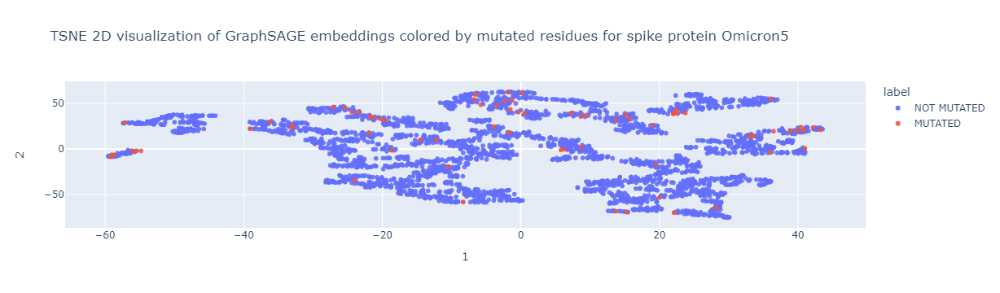

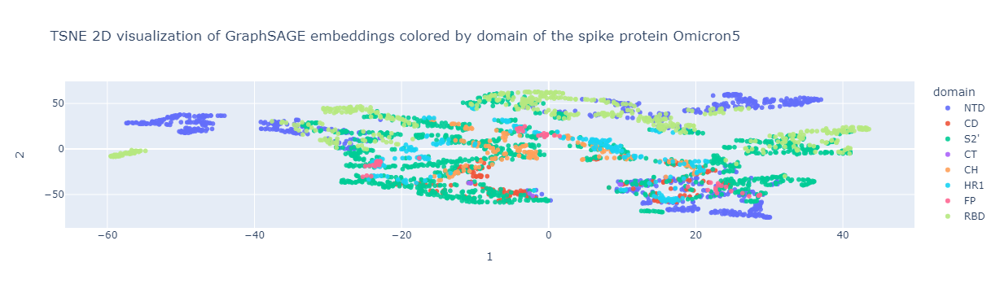

In [57]:
fig1, fig2 = unsupervisedGraphSAGE(G_s[variant], variant, number_of_walks=100, length=4, batch_size=50, epochs=10, num_samples = [10, 10], layer_sizes = [32, 16])

In [ ]:
fig1, fig2 = unsupervisedGraphSAGE(G_s["Delta"], "Delta",  number_of_walks=100, length=10, batch_size=50, epochs=10, num_samples = [10, 10], layer_sizes = [32, 16])#ns 50

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


65/65 [==============================] - 3s 29ms/step


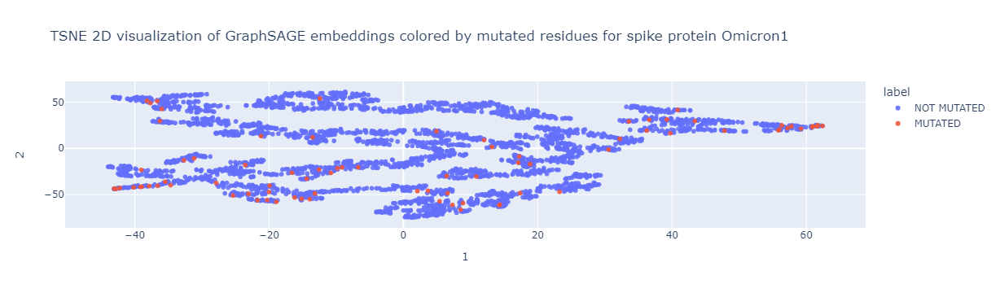

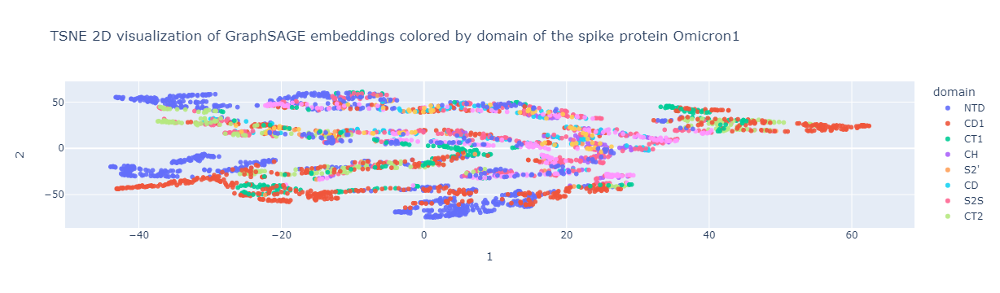

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



64/64 [==============================] - 2s 31ms/step


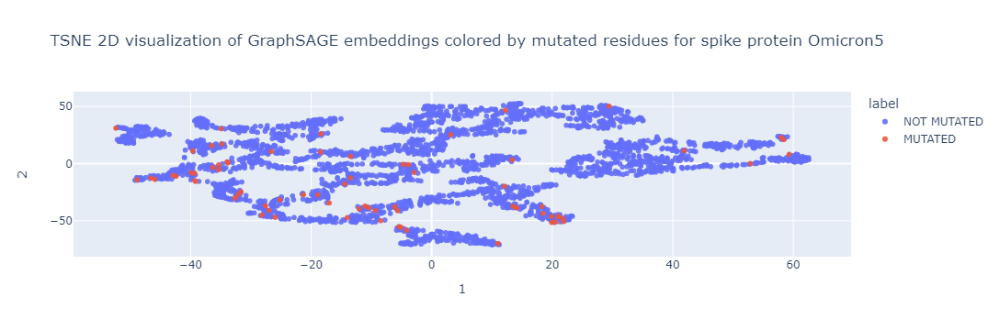

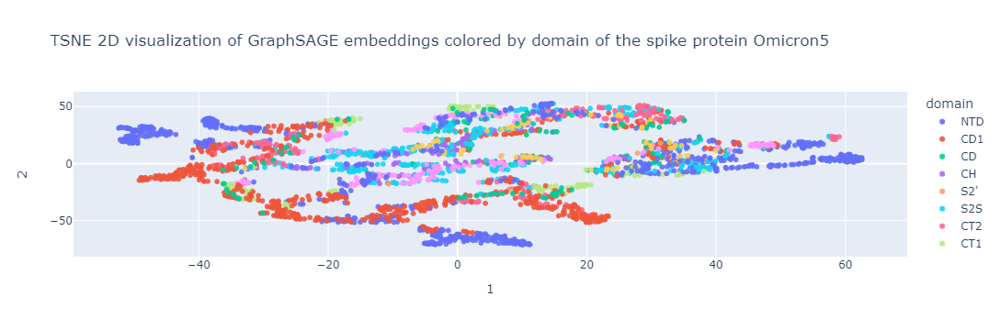

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



68/68 [==============================] - 3s 31ms/step


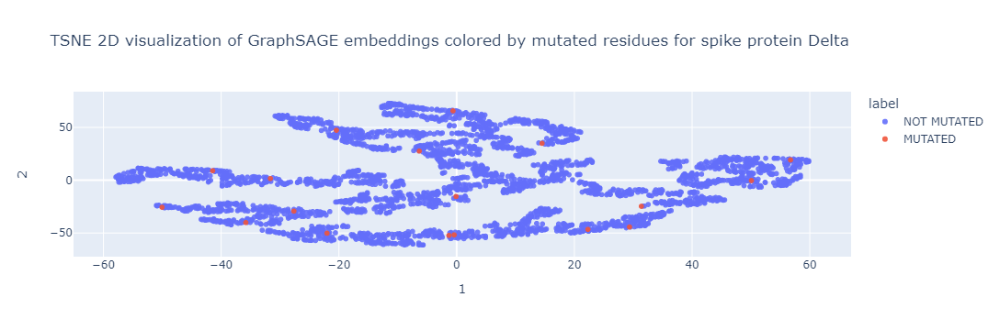

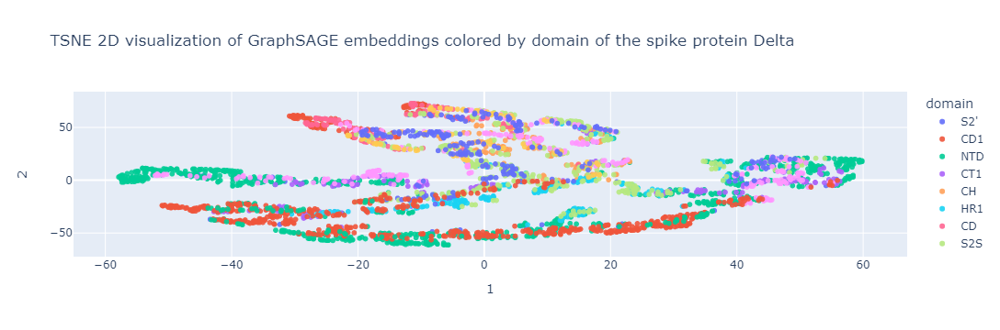

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



65/65 [==============================] - 3s 31ms/step


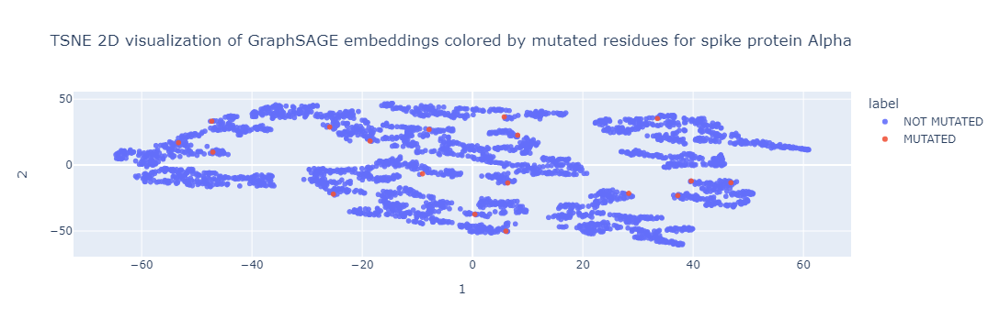

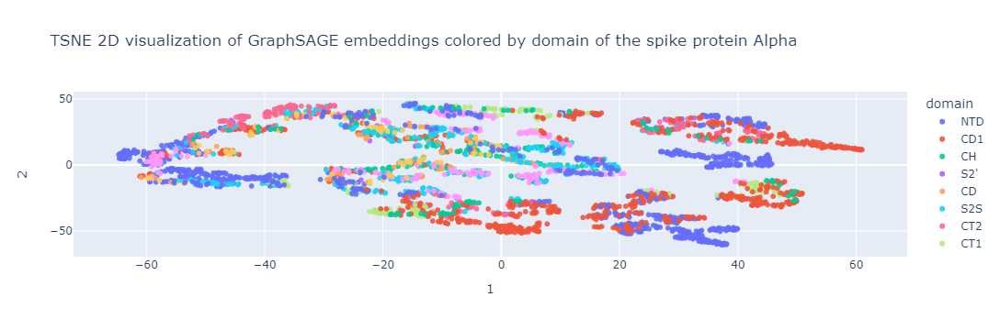

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



65/65 [==============================] - 2s 30ms/step


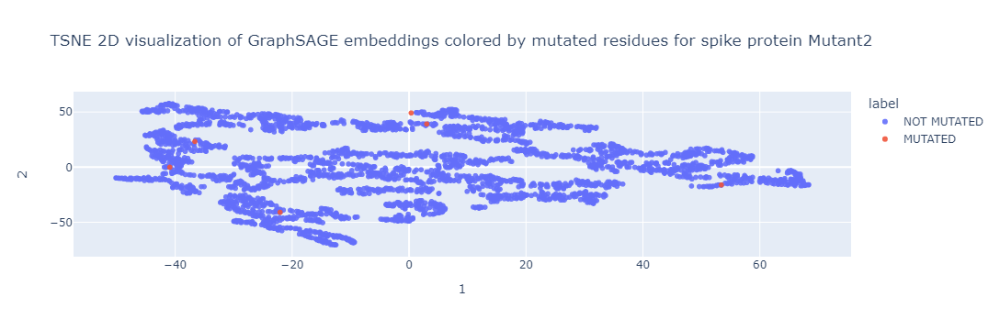

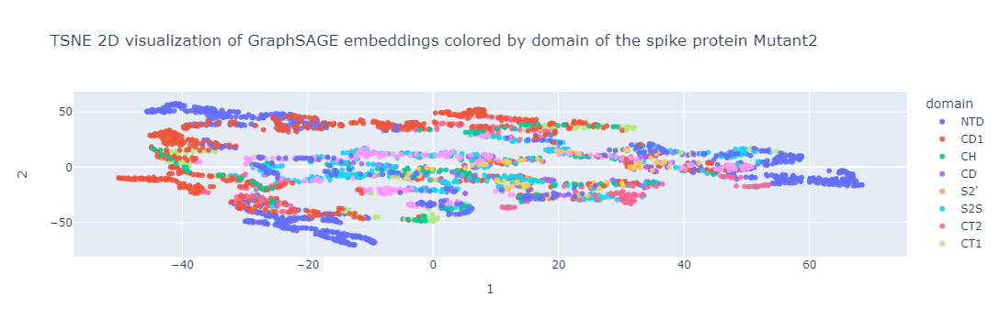

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



80/80 [==============================] - 3s 31ms/step


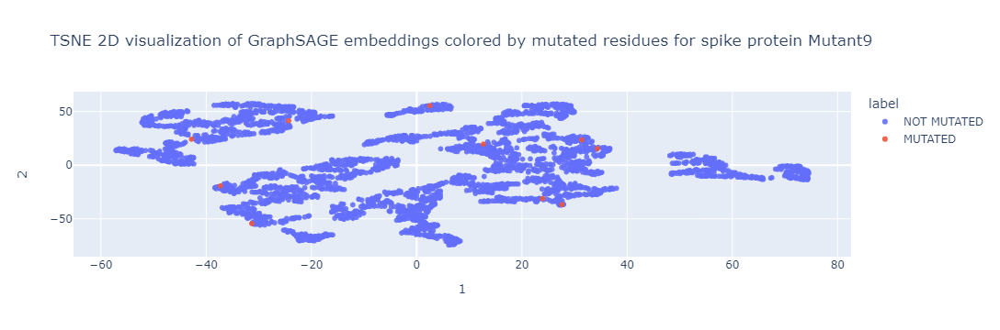

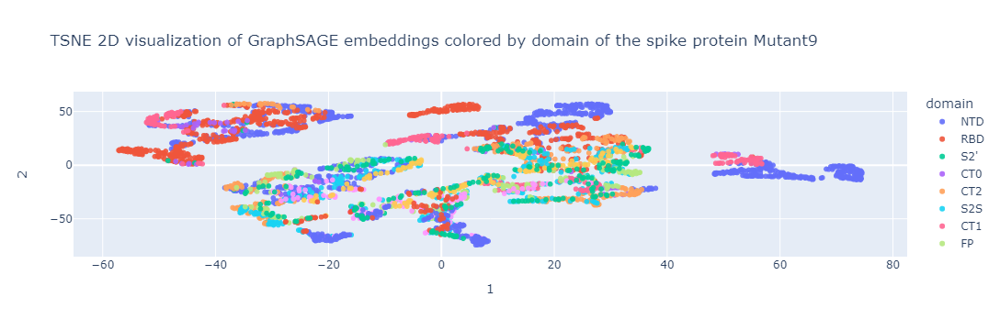

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



80/80 [==============================] - 3s 29ms/step


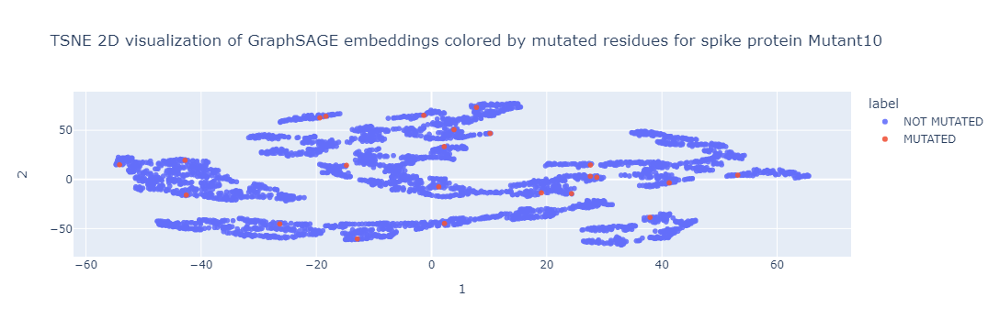

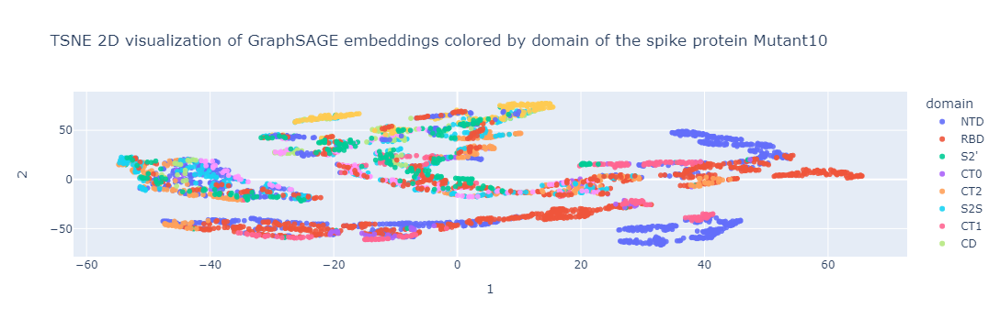

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



68/68 [==============================] - 3s 30ms/step


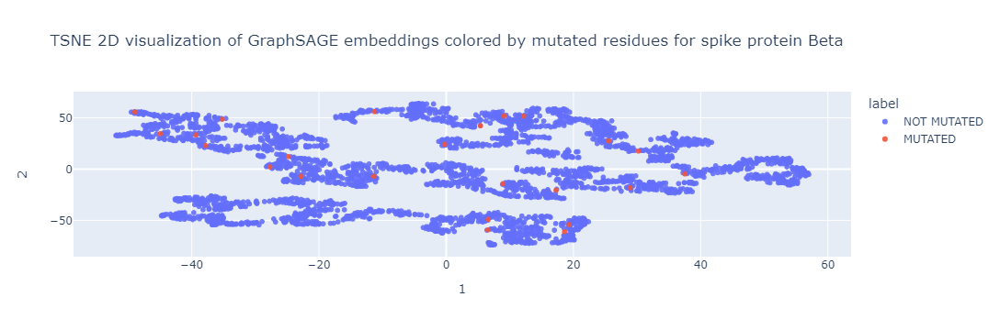

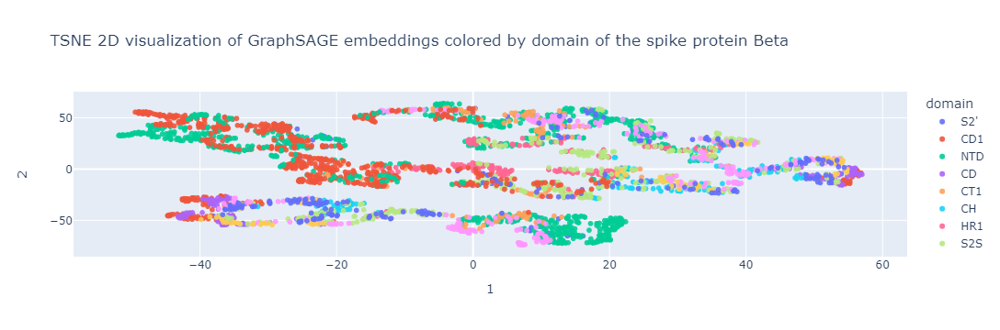

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



64/64 [==============================] - 2s 30ms/step


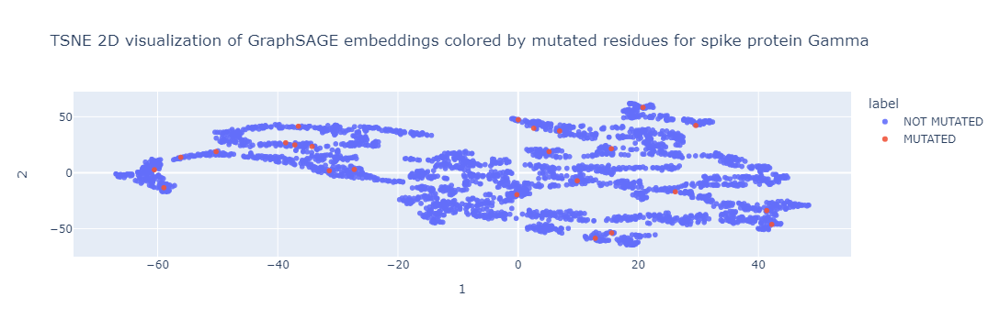

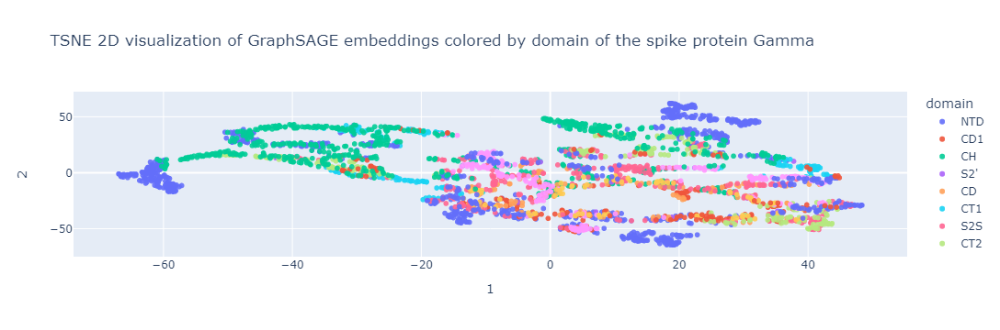

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



65/65 [==============================] - 3s 32ms/step


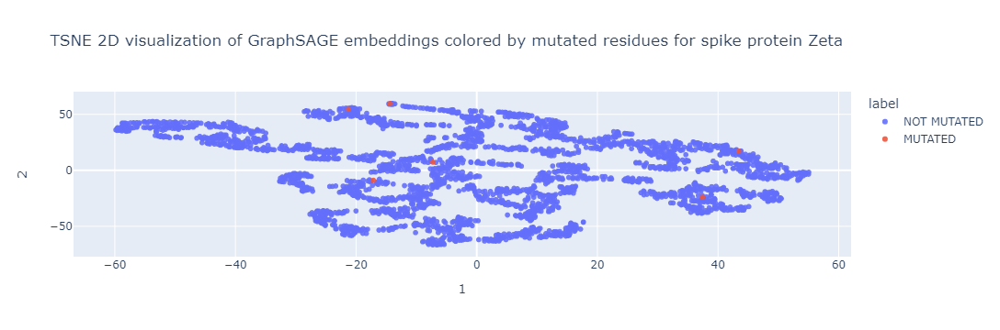

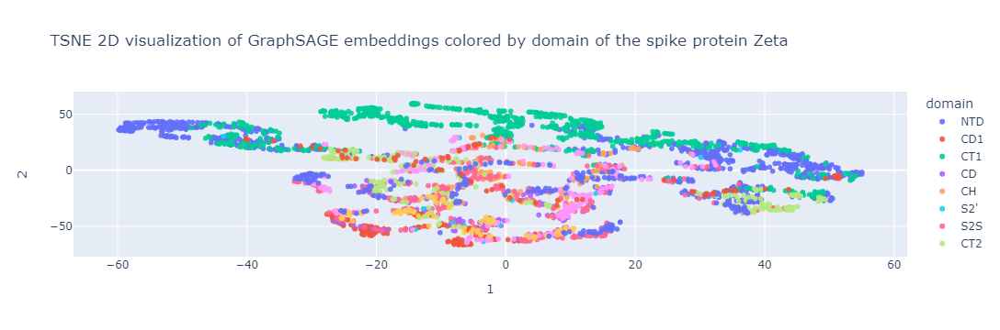

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



80/80 [==============================] - 3s 29ms/step


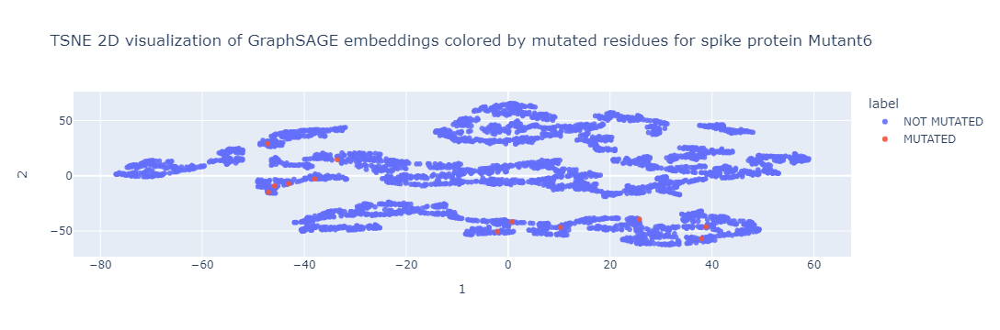

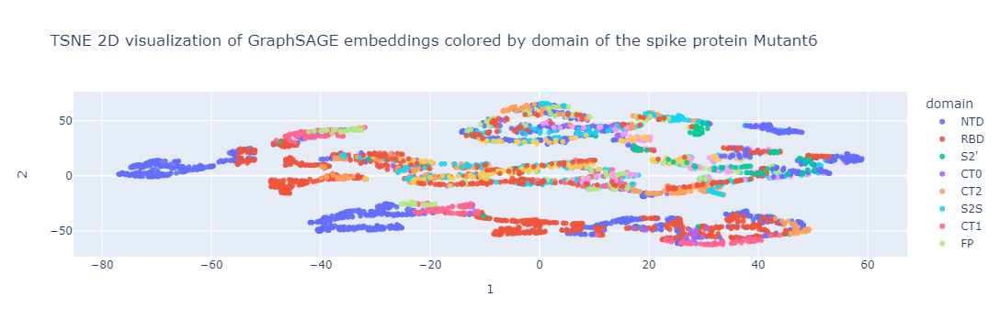

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



80/80 [==============================] - 3s 30ms/step


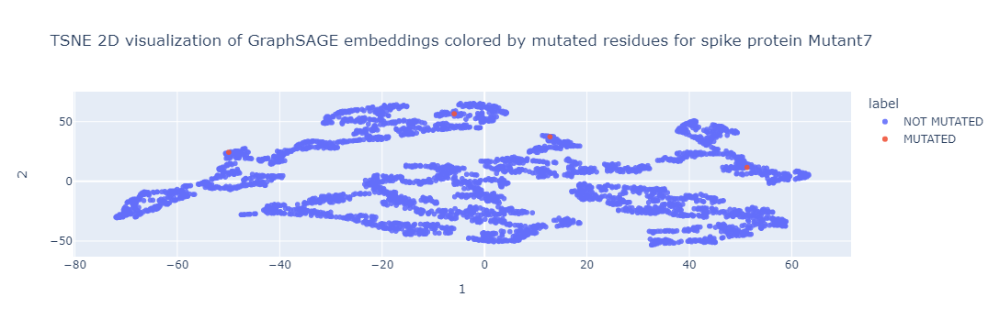

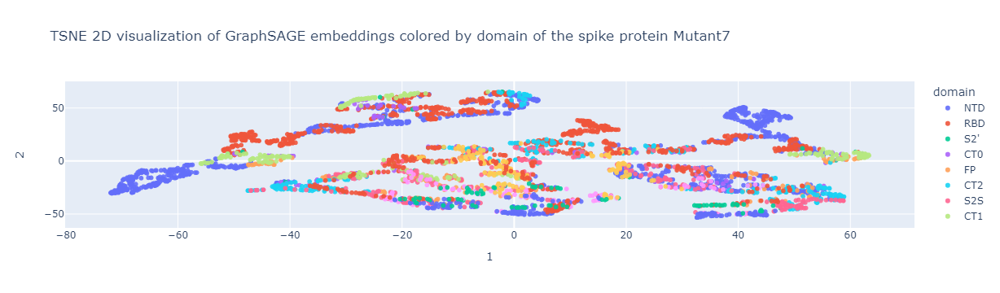

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



68/68 [==============================] - 3s 35ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



80/80 [==============================] - 3s 30ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



68/68 [==============================] - 3s 31ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



65/65 [==============================] - 2s 28ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



64/64 [==============================] - 2s 29ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



64/64 [==============================] - 2s 33ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



65/65 [==============================] - 2s 30ms/step


C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



63/63 [==============================] - 2s 32ms/step


In [13]:
for name, G in G_s.items():
    if "Wild Type" not in name:
        unsupervisedGraphSAGE(G, name = name, number_of_walks=100, length=10, batch_size=50, epochs=10, num_samples = [10, 10], layer_sizes = [32, 16])

In [20]:
def plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=None, normalize=False):
        
        """
    given a sklearn confusion matrix (cm), make a nice plot

    Arguments
    ---------
    cm:           confusion matrix from sklearn.metrics.confusion_matrix

    target_names: given classification classes such as [0, 1, 2]
                  the class names, for example: ['high', 'medium', 'low']

    title:        the text to display at the top of the matrix

    cmap:         the gradient of the values displayed from matplotlib.pyplot.cm
                  see http://matplotlib.org/examples/color/colormaps_reference.html
                  plt.get_cmap('jet') or plt.cm.Blues

    normalize:    If False, plot the raw numbers
                  If True, plot the proportions

    Usage
    -----
    plot_confusion_matrix(cm           = cm,                  # confusion matrix created by
                                                              # sklearn.metrics.confusion_matrix
                          normalize    = True,                # show proportions
                          target_names = y_labels_vals,       # list of names of the classes
                          title        = best_estimator_name) # title of graph

    Citiation
    ---------
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html

        """
        import itertools
        import matplotlib.pyplot as plt
        
        accuracy = np.trace(cm) / float(np.sum(cm))
        misclass = 1 - accuracy
        
        if cmap is None:
            cmap = plt.get_cmap('Blues')

        plt.figure(figsize=(10, 10))
        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title)
        plt.colorbar()

        if target_names is not None:
            
            plt.xticks(np.arange(len(target_names)), target_names, rotation=45)
            plt.yticks(np.arange(len(target_names)), target_names)

        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

        thresh = cm.max() / 1.5 if normalize else cm.max() / 2
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            if normalize:
                plt.text(j, i, "{:0.4f}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")
            else:
                plt.text(j, i, "{:,}".format(cm[i, j]),
                         horizontalalignment="center",
                         color="white" if cm[i, j] > thresh else "black")

        plt.tight_layout()
        plt.ylabel('True label')
        plt.xlabel('Predicted label\naccuracy={:0.4f}; misclass={:0.4f}'.format(accuracy, misclass))
        plt.show()

def spikeProteinNodes_TrainTestSplit(G, name):
    
    from sklearn import model_selection
    
    node_ids = list(G.nodes())
    features = G.node_features()
    
    for variant in list(spike_muts_variants.keys()):
        if variant in name:
            variant_mutations = spike_muts_variants[variant]
    print(variant, variant_mutations)
    #LABELS
    labels_original = np.zeros((len(node_ids)), dtype = "U14")
    classes = ["NOT MUTATED", "MUTATED"]
    labels = np.zeros((len(node_ids)), dtype = int)
    nodes = []
    label_nodes = []
    idx = 0
    for i, node_id in enumerate(node_ids):
        
        node = int(node_id.split()[0][3:])
        if node in variant_mutations:
            labels[i] = 1 #mutated
            labels_original[i] = "MUTATED" # mutated
        else:
            labels[i] = 0 #not mutated
            labels_original[i] = "NOT MUTATED" #not mutated
                
        if node_id.split()[0] not in nodes:
            nodes.append(node_id.split()[0])
            label_nodes.append(labels[idx])
            idx += 1
    
    train_nodes, test_nodes, train_labels0, test_labels0 = model_selection.train_test_split(nodes, label_nodes, test_size=0.5, stratify=label_nodes)
    chains_spike = ["A"]
    
    for train_node in train_nodes:
        if train_node in test_nodes:
            print("Train node {} is in Test nodes too. Error!".format(train_node))
    
    train_features = []
    test_features = []
    train_labels = []
    test_labels = []
    nodes = []
    #train_labels = train_labels0
    #test_labels = test_labels0
    
    for i, node in enumerate(train_nodes): 
        #temp = []
        for chain in chains_spike:
            #temp.append(G.node_features(nodes=["{} {}".format(node, chain)]))
            train_features.append(G.node_features(nodes=["{} {}".format(node, chain)]).flatten())
            train_labels.append(train_labels0[i])
            nodes.append("{} {}".format(node, chain))
        #train_features.append(np.mean(temp))
    for i, node in enumerate(test_nodes): 
        #temp = []
        for chain in chains_spike:
            #temp.append(G.node_features(nodes=["{} {}".format(node, chain)]))
            test_features.append(G.node_features(nodes=["{} {}".format(node, chain)]).flatten())
            test_labels.append(test_labels0[i])
            nodes.append("{} {}".format(node, chain))
        #test_features.append(np.mean(temp))
            
    return np.array(train_features), np.array(test_features), np.array(train_labels), np.array(test_labels), nodes

def features_final(node_ids, all_nodes, features):
    
    final_features = np.zeros((len(node_ids), features.shape[1]))
    for index, node1 in enumerate(all_nodes):
        temp_list_node_f = []
        for i, node in enumerate(node_ids):
            if node in node1:
                temp_list_node_f.append(features[index])        
            if len(temp_list_node_f) == 3:
                final_features[i] = np.mean(temp_list_node_f)
                break
        
    return final_features

def final_metrics(y_true, y_pred):
    from sklearn.metrics import f1_score, roc_auc_score
    
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    err_rate = (fp + fn) / (tp + tn + fn + fp)
    print("Error rate  : ", err_rate)
    #acc = (tp + tn) / (tp + tn + fn + fp)
    acc = 1-err_rate
    print("Accuracy  : ", acc)
    sens = tp / (tp + fn)
    print("Sensitivity (TPR): ", sens)
    sp = tn / (tn + fp)
    print("Specificity : ", sp)
    FPR = fp / (tn + fp)
    print("False positive rate  : ", FPR)
    f1 = f1_score(y_true, y_pred) 
    print("f1 score: ", f1)
    auc =  roc_auc_score(y_true, y_pred)
    print("ROC AUC: ", auc)

#layer_size: a list of hidden feature sizes of each layer in the model. More and bigger layers allow for better predictions but also overfitting. Not different from classic machine learning.
    
def nodeClassificationGraphSAGE(G, name, train_features, train_labels, test_features, test_labels, nodes, batch_size = 2, num_samples = [10], layer_sizes=[20], epochs = 40, class_weight = True, activation = "softmax", do = 0.0):
    
    import networkx as nx
    import pandas as pd

    import stellargraph as sg
    from stellargraph.mapper import GraphSAGENodeGenerator
    from stellargraph.layer import GraphSAGE

    from tensorflow.keras import layers, optimizers, losses, metrics, Model
    from sklearn import preprocessing, feature_extraction, model_selection
    from sklearn.metrics import confusion_matrix
    from sklearn.utils.class_weight import compute_class_weight
        
    features = np.concatenate((train_features, test_features))
    labels = np.concatenate((train_labels, test_labels))
    labels_original = labels.astype('U14')
    labels_original[labels_original == 0] = "NOT MUTATED"
    labels_original[labels_original == 1] = "MUTATED"
    
    train_index = []
    for train_feature in train_features:
        for idx, feature in enumerate(features):
            if (train_feature == feature).all():
                train_index.append(nodes[idx])
                break
    
    test_index = []
    for test_feature in test_features:
        for idx, feature in enumerate(features):
            if (test_feature == feature).all():
                test_index.append(nodes[idx])
                break
                
    train_classes, train_count = np.unique(train_labels, return_counts=True)
    train_distribution = dict(zip(train_classes, train_count))
    print("train data distribution: {}".format(train_distribution))
    
    if class_weight:
    
        class_weights = compute_class_weight(
                                            class_weight = "balanced",
                                            classes = train_classes,
                                            y = train_labels                                                    
                                        )
        class_weights = dict(zip(train_classes, class_weights))
    
    else:
        class_weights = None
    
    if activation == "softmax":
        units = 2 
        encoder = preprocessing.LabelBinarizer()
        train_labels = encoder.fit_transform(train_labels)
        test_labels = encoder.transform(test_labels)
        loss = losses.binary_crossentropy
        metric = "accuracy"
    elif activation == "sigmoid":
        units = 1
        loss = losses.binary_crossentropy
        metric = metrics.binary_accuracy
        #metric = "accuracy"
        
    generator= GraphSAGENodeGenerator(G, batch_size, num_samples)
    train_gen = generator.flow(train_index, train_labels, shuffle=False)#True
    test_gen = generator.flow(test_index, test_labels, shuffle=False)
    graphsage_model = GraphSAGE(
        layer_sizes=layer_sizes, generator=generator, bias=True, dropout=do
    )
    
    x_inp, x_out = graphsage_model.in_out_tensors()

    #train        
    prediction = layers.Dense(units=units, activation=activation)(x_out) #1 sigmoid or 2 softmax
    model = Model(inputs=x_inp, outputs=prediction)
    model.compile(
        optimizer=optimizers.Adam(lr=0.005),
        loss = loss,
        metrics=[metric]
    )
    print(model.summary())

    history = model.fit(
        train_gen, epochs=epochs, batch_size = batch_size, validation_data=test_gen, shuffle=False, class_weight=class_weights
    ) #verbose=0
    
    if activation == "softmax":
        train_labels = train_labels.flatten()
        test_labels = test_labels.flatten()
        labels = labels.flatten()
    
    print("\nTrain Set Metrics of the trained model:")
    train_metrics = model.evaluate(train_gen)
    for name_, val in zip(model.metrics_names, train_metrics):
        print("\t{}: {:0.4f}".format(name_, val))
    train_pred = model.predict(train_gen)
    train_pred = np.argmax(train_pred, axis=1)
    cnf_matrix_train = confusion_matrix(train_labels,train_pred)
    plot_confusion_matrix(cnf_matrix_train, classes)
    
    print("\nTest Set Metrics of the trained model:")
    test_metrics = model.evaluate(test_gen)
    for name_, val in zip(model.metrics_names, test_metrics):
        print("\t{}: {:0.4f}".format(name_, val))
    test_pred = model.predict(test_gen)
    test_pred = np.argmax(test_pred, axis=1)
    cnf_matrix_test = confusion_matrix(test_labels, test_pred)
    plot_confusion_matrix(cnf_matrix_test, classes)

    #predictions
    all_mapper = generator.flow(nodes)
    all_predictions = model.predict(all_mapper)
    node_predictions = np.argmax(all_predictions, axis=1)
    cnf_matrix = confusion_matrix(labels, node_predictions)
    plot_confusion_matrix(cnf_matrix, classes)
    
    print("Final Metrics: ")
    final_metrics(labels.flatten(), node_predictions)
    
    #node embeddings
    
    embedding_model = Model(inputs=x_inp, outputs=x_out)
    node_embeddings = embedding_model.predict(all_mapper)
    emb_transformed = visualize_embeddings3D(G, node_embeddings, name, batch_size, num_samples)
    
    node_predictions = node_predictions.astype('U14')
    node_predictions[node_predictions == '0'] = "NOT MUTATED"
    node_predictions[node_predictions == '1'] = "MUTATED"
    df = pd.DataFrame({"Predicted": node_predictions, "True": list(labels_original)}, index = nodes)
    
    return df, emb_transformed


def final_decision(df, name):
    from sklearn.metrics import confusion_matrix
    
    nodes = list(df.index)
    y_true = df["True"]
    y_pred = df["Predicted"]
            
    true_final = np.zeros((len(nodes), 3), dtype = "U14") #3 number of chains
    predicted_final = np.zeros((len(nodes), 3), dtype = "U14")
    nodes_final = []
    for i, node in enumerate(nodes):
        if node not in nodes_final:
            nodes_final.append(node)
        chain = str(node.split()[1])
            
        for j in range(3):
            if not str(true_final[i, j]).strip():
                true_final[i, j] = y_true[node]
        for j in range(3):
            if not str(predicted_final[i, j]).strip():
                predicted_final[i, j] = y_pred[node]
        
    true = []
    predicted = []
    
    for i, node in enumerate(nodes_final):

        count_true_mutated = np.count_nonzero(true_final[i, :] == "MUTATED")
        count_true_not_mutated = np.count_nonzero(true_final[i, :] == "NOT MUTATED")
        count_predicted_mutated = np.count_nonzero(predicted_final[i, :] == "MUTATED")
        count_predicted_not_mutated = np.count_nonzero(predicted_final[i, :] == "NOT MUTATED")
        
        if count_true_mutated >= count_true_not_mutated:
            temp_true = "MUTATED"
        else:
            temp_true = "NOT MUTATED"
        if count_predicted_mutated >= 1:
        #if count_predicted_mutated >= count_predicted_not_mutated:
            temp_predicted = "MUTATED"
        else:
            temp_predicted = "NOT MUTATED"
        true.append(temp_true)
        predicted.append(temp_predicted)
    
    final_df = pd.DataFrame({"Predicted": predicted, "True": true}, index = nodes_final)
    
    print("Final Confusion matrix: ")
    cnf_matrix = confusion_matrix(true, predicted)
    plot_confusion_matrix(cnf_matrix, ["NOT MUTATED", "MUTATED"])
    
    return final_df             

In [302]:
name = "Omicron1"
G = G_s[name]
features = G.node_features() 
node_ids = list(G.nodes())
        
for variant in list(spike_muts_variants.keys()):
    if variant in name:
        variant_mutations = spike_muts_variants[variant]

In [303]:
#LABELS
labels= np.zeros((len(node_ids)), dtype = "U14")
labels_num= np.zeros((len(node_ids)), dtype = int)
classes = ["NOT MUTATED", "MUTATED"]
for i, node_id in enumerate(node_ids):

    node = int(node_id.split()[0][3:])
    if node in variant_mutations:
        labels[i] = "MUTATED" #mutated
        labels_num[i] = 1
    else:
        labels[i] = "NOT MUTATED" #not mutated
        labels[i] = 0

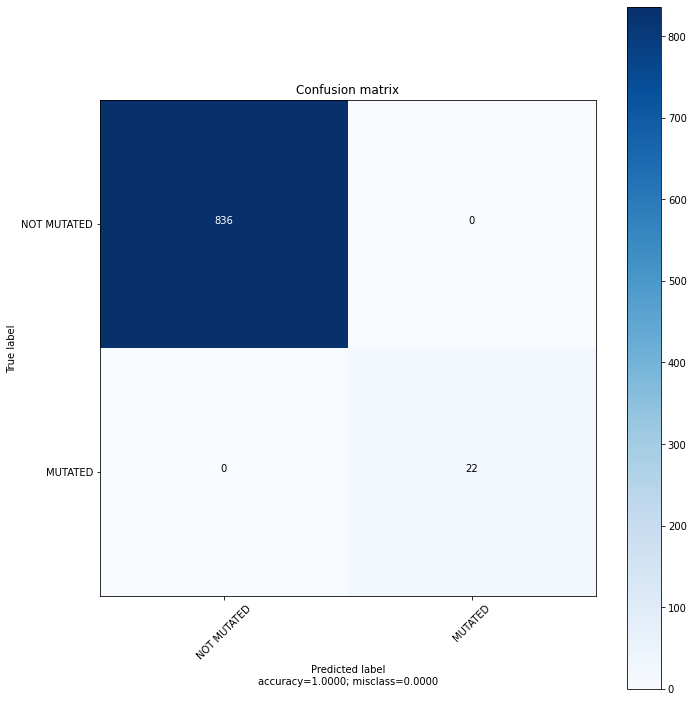

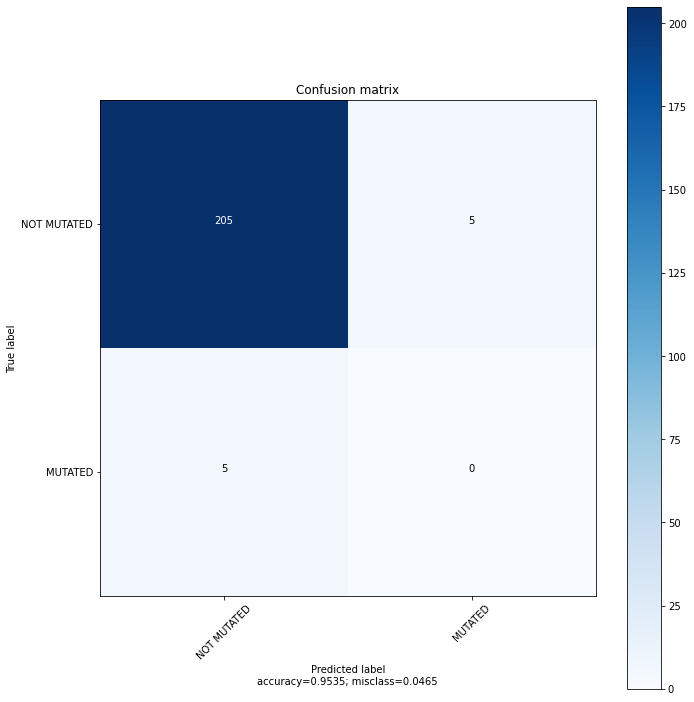

In [304]:
#knn
from sklearn import model_selection
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix
    
train_features, test_features, train_labels, test_labels = model_selection.train_test_split(features, labels, test_size=0.2, stratify=labels)
model = KNeighborsClassifier(n_neighbors=1).fit(train_features, y=train_labels)
#model = SVC(C=2, gamma = "auto", kernel = "sigmoid").fit(train_features, train_labels)
y_pred = model.predict(train_features)
cnf_matrix = confusion_matrix(train_labels, y_pred)
plot_confusion_matrix(cnf_matrix, classes)
y_pred = model.predict(test_features)
cnf_matrix = confusion_matrix(test_labels, y_pred)
plot_confusion_matrix(cnf_matrix, classes)


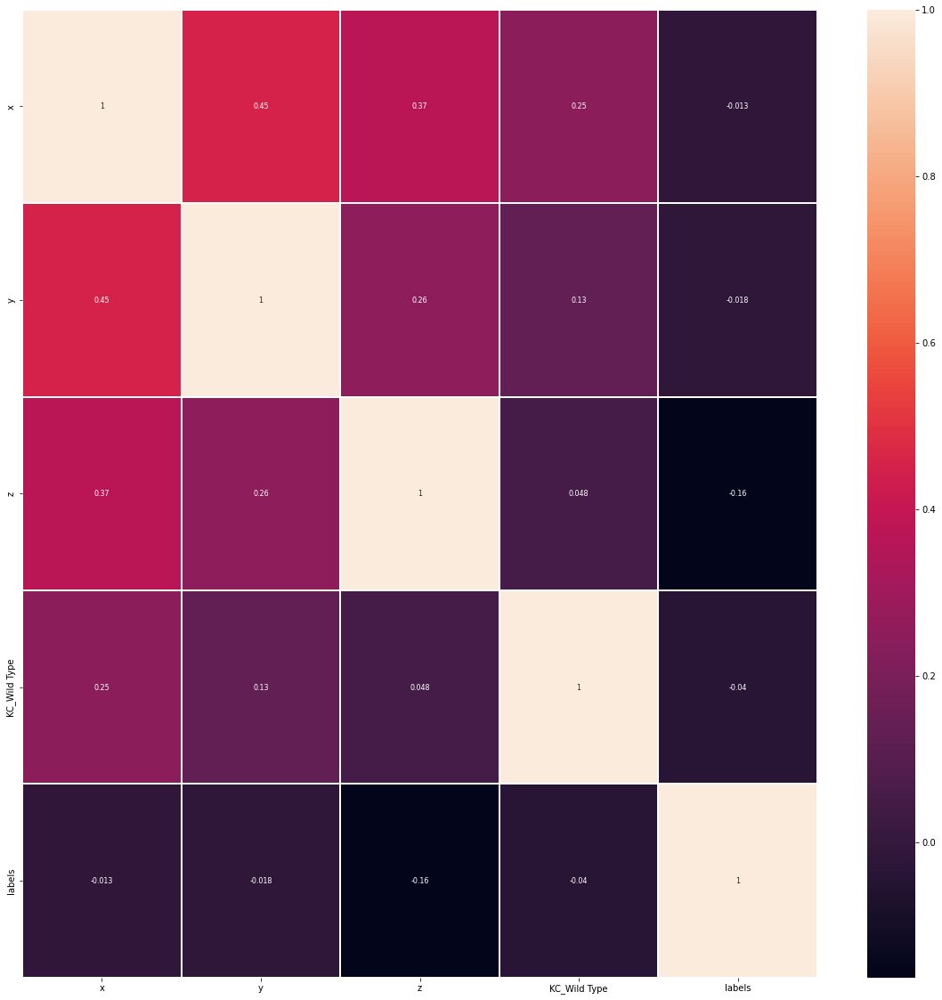

In [305]:
import seaborn as sb
import matplotlib.pyplot as plt

columns = list(features_names)
columns.append("labels")
dataframe_features = pd.DataFrame(np.column_stack((features,labels_num)), columns = columns, index = node_ids)
dict_ = dict()
for column in columns:
    dict_[column] = 'float'
dict_["labels"] = 'int'
dataframe_features = dataframe_features.astype(dict_)
corr = dataframe_features.corr()
fig, ax = plt.subplots(figsize=(20,20))        
sb.heatmap(corr, annot=True, linewidths=0.2, ax=ax,  annot_kws={"fontsize":8})#annot_kws per settare il fontsize
plt.show()


In [306]:
train_features, test_features, train_labels, test_labels, nodes = spikeProteinNodes_TrainTestSplit(G_s[name], name)
train_features.shape, test_features.shape, train_labels.shape, test_labels.shape 

Wild Type [ 67  95 142 212 339 371 373 375 417 440 446 477 478 484 493 496 498 501
 505 547 614 655 679 681 764 796 856 954 969 981]


((536, 4), (537, 4), (536,), (537,))

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_12412\2199968162.py:193: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_12412\2199968162.py:194: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

C:\Users\ugo-c\anaconda3\envs\PCN\lib\site-packages\keras\initializers\initializers_v2.py:120: UserWarning:

The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.



train data distribution: {0: 523, 1: 13}
Model: "model_25"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_112 (InputLayer)         [(None, 64, 4)]      0           []                               
                                                                                                  
 input_113 (InputLayer)         [(None, 2048, 4)]    0           []                               
                                                                                                  
 input_111 (InputLayer)         [(None, 1, 4)]       0           []                               
                                                                                                  
 reshape_142 (Reshape)          (None, 1, 64, 4)     0           ['input_112[0][0]']              
                                                  

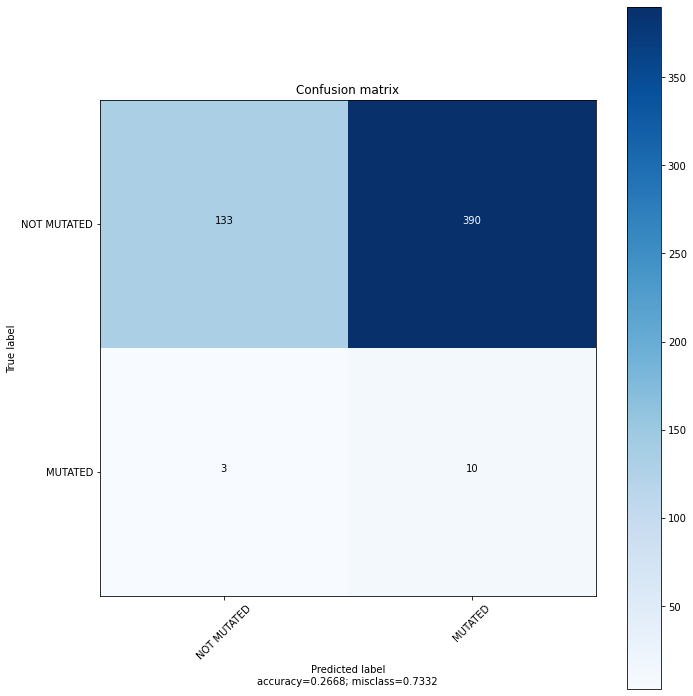


Test Set Metrics of the trained model:
269/269 [==============================] - 3s 11ms/step - loss: 0.5495 - accuracy: 0.2626
	loss: 0.5495
	accuracy: 0.2626
269/269 [==============================] - 3s 11ms/step


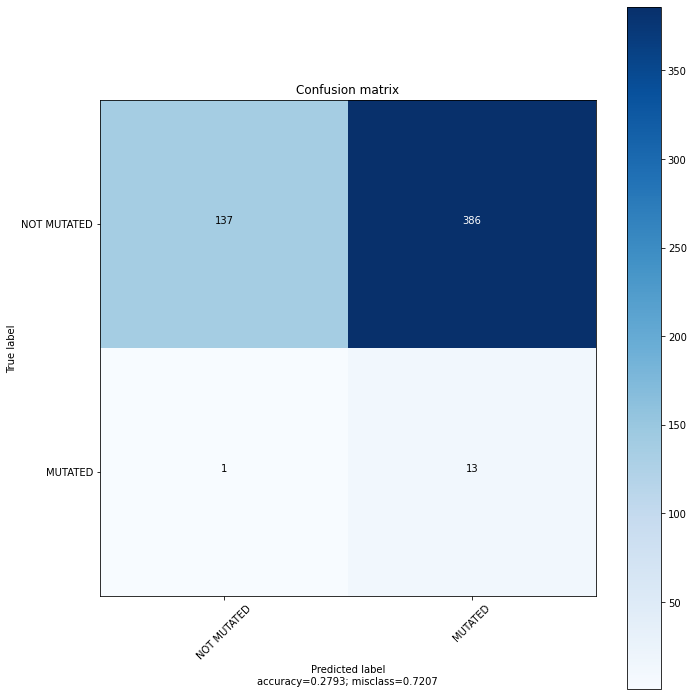

537/537 [==============================] - 6s 11ms/step


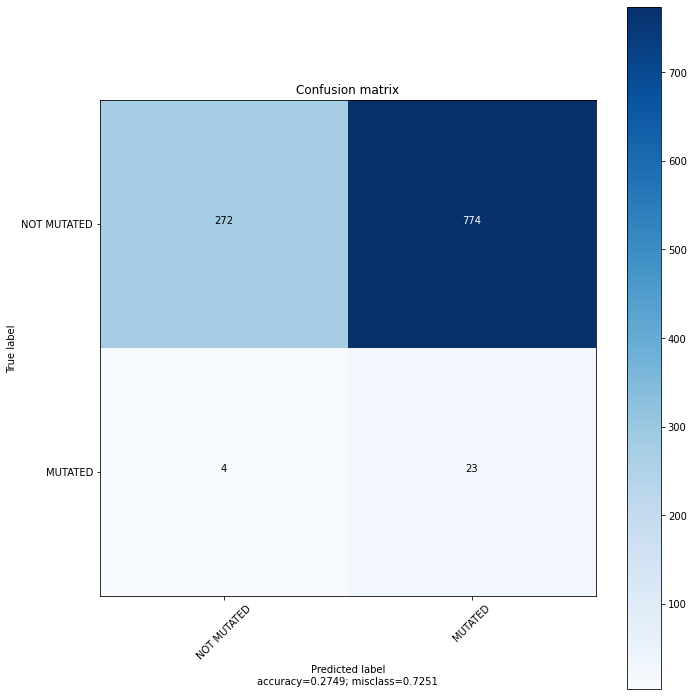

Final Metrics: 
Error rate  :  0.7250698974836906
Accuracy  :  0.27493010251630945
Sensitivity (TPR):  0.8518518518518519
Specificity :  0.26003824091778205
False positive rate  :  0.739961759082218
f1 score:  0.055825242718446605
ROC AUC:  0.5559450463848169
537/537 [==============================] - 6s 11ms/step


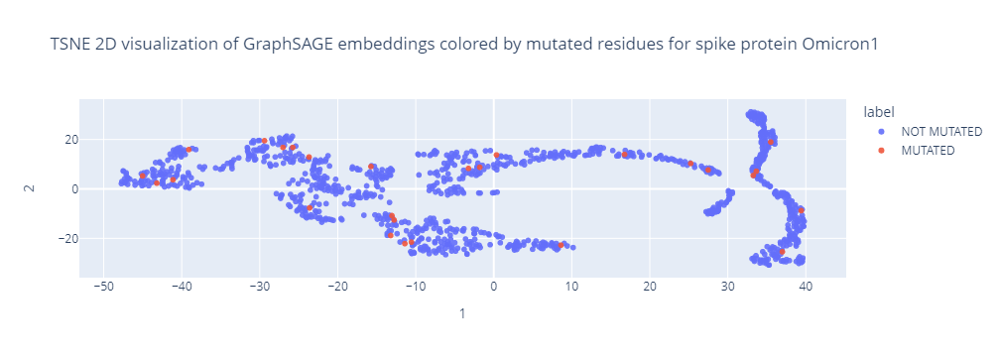

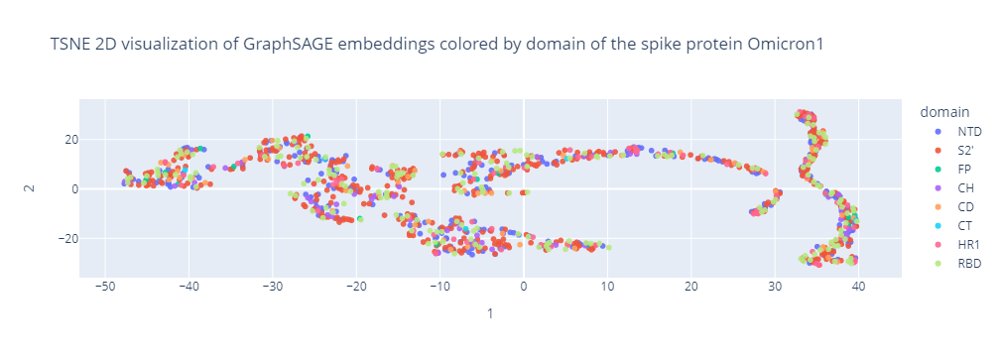

In [308]:
df, emb = nodeClassificationGraphSAGE(G_s[name], name, train_features, train_labels, test_features, test_labels, nodes, num_samples = [64, 32], layer_sizes=[64, 64], activation = "softmax", do = 0.5)

In [296]:
df[df["Predicted"]!=df["True"]]

,Predicted,True
GLY416 A,MUTATED,0
VAL503 A,NOT MUTATED,0
VAL952 A,MUTATED,0
GLY550 A,MUTATED,0
LEU828 A,MUTATED,0
...,...,...
ARG577 A,MUTATED,0
VAL610 A,MUTATED,0
VAL36 A,MUTATED,0
VAL227 A,MUTATED,0


Final Confusion matrix: 


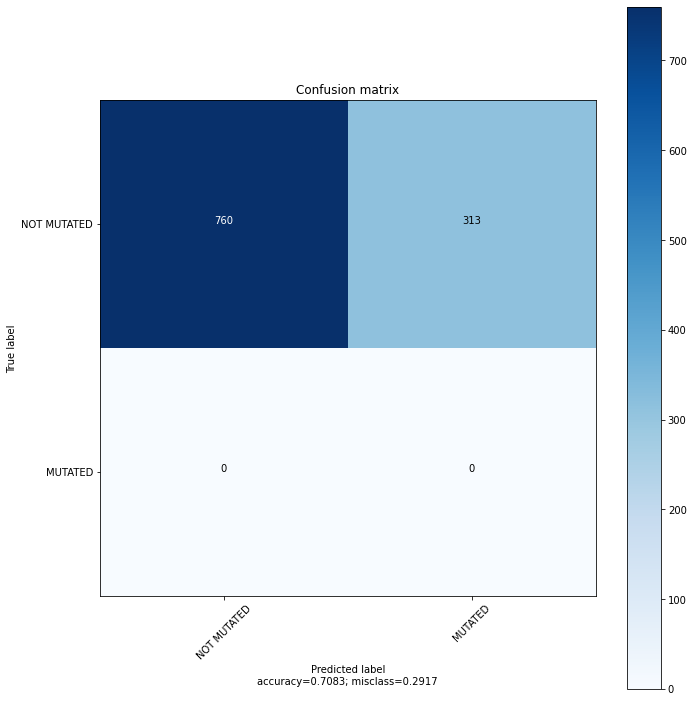

,Predicted,True
GLY416 A,MUTATED,MUTATED
VAL503 A,MUTATED,MUTATED
VAL952 A,MUTATED,MUTATED
GLY550 A,MUTATED,MUTATED
LEU828 A,NOT MUTATED,MUTATED
...,...,...
ARG577 A,MUTATED,MUTATED
VAL610 A,MUTATED,MUTATED
VAL36 A,MUTATED,MUTATED
VAL227 A,MUTATED,MUTATED


In [299]:
final_df = final_decision(df, name)
final_df

In [290]:
import pandas as pd
pd.set_option('display.max_rows', 500)
final_df[final_df["Predicted"]!=final_df["True"]]

,Predicted,True
VAL503 A,NOT MUTATED,MUTATED
ILE980 A,NOT MUTATED,MUTATED
SER746 A,NOT MUTATED,MUTATED
LEU752 A,NOT MUTATED,MUTATED
GLU471 A,NOT MUTATED,MUTATED
GLY744 A,NOT MUTATED,MUTATED
SER750 A,NOT MUTATED,MUTATED
TYR449 A,NOT MUTATED,MUTATED
LYS444 A,NOT MUTATED,MUTATED
ASP985 A,NOT MUTATED,MUTATED


In [291]:
final_df[final_df["Predicted"]!=final_df["True"]][final_df["True"]=="MUTATED"]
#key mutations of omicron 417, 440, 446, 477, 478, 484, 493, 496, 498, 501, 505, 681 source: https://gvn.org/covid-19/omicron-b-1-1-529/

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_12412\1721968966.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Predicted,True
VAL503 A,NOT MUTATED,MUTATED
ILE980 A,NOT MUTATED,MUTATED
SER746 A,NOT MUTATED,MUTATED
LEU752 A,NOT MUTATED,MUTATED
GLU471 A,NOT MUTATED,MUTATED
GLY744 A,NOT MUTATED,MUTATED
SER750 A,NOT MUTATED,MUTATED
TYR449 A,NOT MUTATED,MUTATED
LYS444 A,NOT MUTATED,MUTATED
ASP985 A,NOT MUTATED,MUTATED


In [292]:
final_df[final_df["Predicted"]!=final_df["True"]][final_df["True"]=="NOT MUTATED"]

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_12412\3244784685.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Predicted,True


In [293]:
final_df[final_df["Predicted"]==final_df["True"]][final_df["True"]=="MUTATED"]

C:\Users\ugo-c\AppData\Local\Temp\ipykernel_12412\246857083.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Predicted,True
GLY416 A,MUTATED,MUTATED
VAL952 A,MUTATED,MUTATED
GLY550 A,MUTATED,MUTATED
LEU828 A,MUTATED,MUTATED
PHE541 A,MUTATED,MUTATED
...,...,...
ARG577 A,MUTATED,MUTATED
VAL610 A,MUTATED,MUTATED
VAL36 A,MUTATED,MUTATED
VAL227 A,MUTATED,MUTATED
